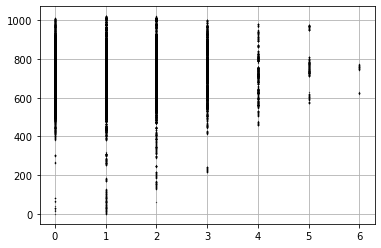

In [1]:
import numpy as np 
import matplotlib.pyplot as plt

#Parameters
ctrc = 0.005
ctrd = 0.167
cmloss = np.log(2)/120
cploss = np.log(2)/3600
tmax = 50
steps = 50000

#Initial Values
t = 0
tt = 0
dt = tmax/steps
mRNA = 0
Protein = 0
DNA = 1        #Constant

#Outputsave
parr = [0]
mrnarr = [0]
tarr = [0]
dtarr = [0]
a_j = [1,2,3,4]

#counter
counter = 1

while counter < steps:
    #Propensities
    a_j[0] = ctrc * DNA
    a_j[1] = ctrd * mRNA
    a_j[2] = cmloss * mRNA
    a_j[3] = cploss * Protein

    #a total
    a_total = sum(a_j)

    #Tau
    rand1 = np.random.rand()
    tau = (1/a_total)*np.log(1/rand1)
    t += tau

    #q
    rand2 = np.random.rand()
    dart = a_total * rand2
    sum_a = 0
    q = 0
    for i in range(len(a_j)):
        sum_a = sum_a + a_j[i]
        if sum_a > dart:
            q = i + 1
            break
    if q == 1:
        mRNA += 1
    elif q == 2:
        Protein += 1
    elif q == 3:
        mRNA -= 1
    elif q == 4:
        Protein -= 1
    
    parr.append(Protein)
    mrnarr.append(mRNA)
    tarr.append(t)
    dtarr.append(tt)
    counter += 1
    tt += dt

plt.plot(mrnarr,parr,'ko',ms=0.3)
plt.grid()
 

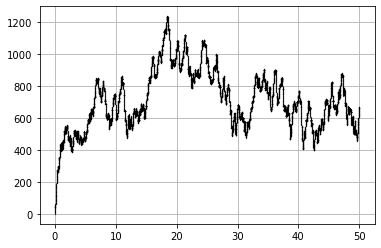

In [3]:
plt.plot(dtarr,parr,'ko',ms=0.1)
plt.grid()

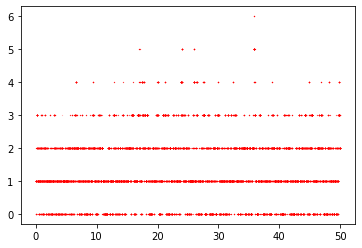

In [15]:
plt.plot(dtarr,mrnarr,'ro',ms=0.1,linewidth=0.3)

In [5]:
r = 0
xarr = [0]
yarr = [0]
K=5
dr = 0.0005
while r < 4:
    P=[0.5]
    for s in range(50):
        p_n = r * P[s] *(1 - (P[s]/K))
        P.append(p_n)
        if s > 30:
            yarr.append(P[s])
            xarr.append(r)
    r += dr

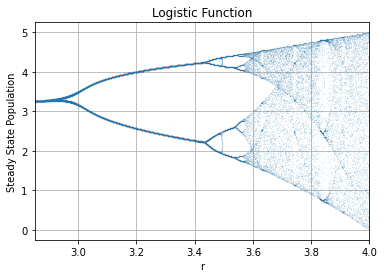

In [6]:
plt.plot(xarr,yarr,'o',ms=0.04)
plt.grid()
plt.xlim(2.85,4)
plt.ylabel('Steady State Population')
plt.xlabel('r')
plt.title('Logistic Function')
plt.savefig('Pop.svg',format='svg', dpi=1200)